In [1]:
!pip install -q jax jaxlib matplotlib
!rm -f jax_wave_solver_gcolab.py
!wget -q https://raw.githubusercontent.com/filkinc/diploma_centpy_parallelization_py/refs/heads/cpu-gpu-google-collab/jax_wave_solver_gcolab.py

In [2]:
import importlib
import jax
import wave_eq_solver_on_jax.jax_wave_solver_gcolab
importlib.reload(wave_eq_solver_on_jax.jax_wave_solver_gcolab)  # на всякий случай
from wave_eq_solver_on_jax.jax_wave_solver_gcolab import JAXWave2D, benchmark
from matplotlib import animation
from IPython.display import HTML

JAX devices: [CudaDevice(id=0)]
u device: cuda:0


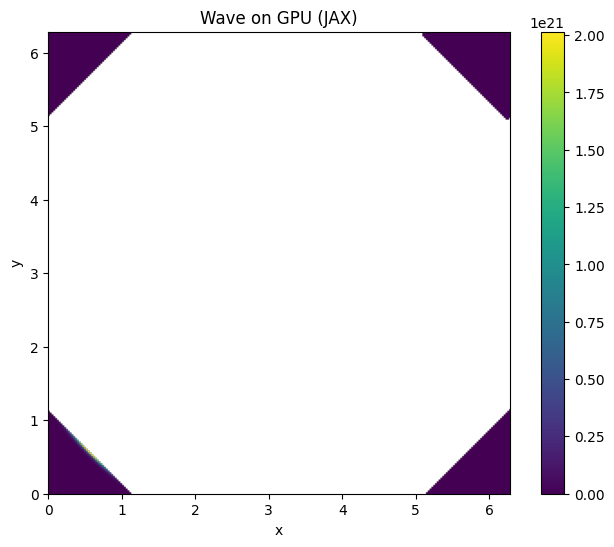

In [4]:
print("JAX devices:", jax.devices())
gpu = jax.devices("gpu")[0]

solver = JAXWave2D(nx=256, ny=256)
u_gpu = solver.solve(steps=500, device=gpu)
print("u device:", u_gpu.device)
solver.plot(u_gpu, title="Wave on GPU (JAX)")

In [7]:
device = jax.devices()[0]

anim = solver.animate(steps=500, every=4, device=device, interval=50)
HTML(anim.to_jshtml())

In [18]:
gpu = jax.devices("gpu")[0]
u_np, u_jax = benchmark(nx=1024, ny=1024, steps=2000, device=gpu)

Device: cuda:0
NumPy: 28.1847 s
JAX 1st (compile+run): 0.9990 s
JAX 2nd (warm):        0.6273 s
Speedup NumPy/JAX:     44.93x
